## Lib

In [1]:
# !pip install spacy
# !pip install transformers datasets
# !pip install scikit-learn
# !pip install numpy requests nlpaug sentencepiece
# !pip install protobuf
# !pip install accelerate
# !pip install sentence-transformers
# !pip install bertviz
# !pip install shap

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

import torch
import torch.nn as nn
import torch.nn.functional as F

from torch.utils.data import DataLoader, Dataset
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
from sklearn.model_selection import train_test_split
from sklearn.manifold import TSNE
from sklearn.metrics.pairwise import cosine_similarity

from transformers import BertTokenizer, BertForSequenceClassification, BertConfig, BertModel
from transformers import LlamaForCausalLM, AutoTokenizer, AutoModelForSeq2SeqLM
from sentence_transformers import SentenceTransformer, util

import nlpaug.augmenter.word as naw

from bertviz import head_view
import shap

import time
from tqdm import tqdm
import random

In [2]:
SEED = 42
random.seed(SEED)           # Python random
np.random.seed(SEED)        # NumPy random
torch.manual_seed(SEED)     # PyTorch CPU
torch.cuda.manual_seed_all(SEED)  # PyTorch GPU (if used)

In [3]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

## Load & Clean Dataset

In [4]:
def create_df(data_file):
    with open(data_file, 'r') as file:
        text_list = []
        label_list = []
        for line in file:
            result = line.strip().split(':')
            label_list.append(result[0])
            text_list_ = result[1].split()
            text_list.append(' '.join(text_list_[1:]))

    data = {
        "text": text_list,
        "label": label_list
    }

    return pd.DataFrame(data)

train_path = 'C:/Users/yauju/Documents/DS notebook/nlp_project/data/train_5500.txt'
train_df = create_df(train_path)
test_df = create_df(r'C:/Users/yauju/Documents/DS notebook/nlp_project/data/TREC_10.txt')
        

In [39]:
train_df

,text,label
0,How did serfdom develop in and then leave Russ...,DESC
1,What films featured the character Popeye Doyle ?,ENTY
2,How can I find a list of celebrities ' real na...,DESC
3,What fowl grabs the spotlight after the Chines...,ENTY
4,What is the full form of .com ?,ABBR
...,...,...
5447,What 's the shape of a camel 's spine ?,ENTY
5448,What type of currency is used in China ?,ENTY
5449,What is the temperature today ?,NUM
5450,What is the temperature for cooking ?,NUM


In [5]:
train_df['label'].value_counts()

label
ENTY    1250
HUM     1223
DESC    1162
NUM      896
LOC      835
ABBR      86
Name: count, dtype: int64

In [27]:
train_df.duplicated().sum()

np.int64(75)

In [12]:
train_df.drop_duplicates(inplace=True)

In [6]:
possible_labels = train_df.label.unique()

label_dict = {}
for index, possible_label in enumerate(possible_labels):
    label_dict[possible_label] = index

index_to_label = {v: k for k, v in label_dict.items()}

label_dict

{'DESC': 0, 'ENTY': 1, 'ABBR': 2, 'HUM': 3, 'NUM': 4, 'LOC': 5}

In [7]:
train_df['label'] = train_df.label.replace(label_dict)
test_df['label'] = test_df.label.replace(label_dict)

C:\Users\yauju\AppData\Local\Temp\ipykernel_21988\3578331454.py:1: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  train_df['label'] = train_df.label.replace(label_dict)
C:\Users\yauju\AppData\Local\Temp\ipykernel_21988\3578331454.py:2: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  test_df['label'] = test_df.label.replace(label_dict)


In [8]:
X_train, X_val, y_train, y_val = train_test_split(train_df['text'], train_df['label'], test_size=0.2, random_state=42)
X_test, y_test = test_df['text'], test_df['label']

## Embeddings Analysis

In [4]:
tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')
model = BertModel.from_pretrained('bert-base-uncased', output_hidden_states=True)

In [11]:
sentences = [
"He sat by the bank of the river.",
"The bank raised its interest rates.",
"She swam near the river.",
"He saved money at the bank.",
"The fisherman sat by the river bank.",
]

encoded = tokenizer(sentences, padding=True, truncation=True, return_tensors='pt')

### Word Level Embedding Analysis

#### Example

In [ ]:
with torch.no_grad():
    outputs = model(**encoded)
    hidden_states = outputs.last_hidden_state  # shape: [batch_size, seq_len, hidden_dim]

In [13]:
for i, sentence in enumerate(sentences):
    tokens = tokenizer.convert_ids_to_tokens(encoded['input_ids'][i])
    print(tokens)

0 ['[CLS]', 'he', 'sat', 'by', 'the', 'bank', 'of', 'the', 'river', '.', '[SEP]']
1 ['[CLS]', 'the', 'bank', 'raised', 'its', 'interest', 'rates', '.', '[SEP]', '[PAD]', '[PAD]']
2 ['[CLS]', 'she', 'swam', 'near', 'the', 'river', '.', '[SEP]', '[PAD]', '[PAD]', '[PAD]']
3 ['[CLS]', 'he', 'saved', 'money', 'at', 'the', 'bank', '.', '[SEP]', '[PAD]', '[PAD]']
4 ['[CLS]', 'the', 'fisherman', 'sat', 'by', 'the', 'river', 'bank', '.', '[SEP]', '[PAD]']


In [19]:
bank_river_emb1 = hidden_states[0,5,:]
bank_river_emb2 = hidden_states[4,7,:]

bank_money_emb1 = hidden_states[1,2,:]
bank_money_emb2 = hidden_states[3,6,:]

river_emb1 = hidden_states[0,8,:]
river_emb2 = hidden_states[2,5,:]
river_emb3 = hidden_states[4,6,:]

interest_emb1 = hidden_states[1,5,:]
money_emb1 = hidden_states[3,3,:]

word_emb_list = [bank_river_emb1, bank_river_emb2, bank_money_emb1, bank_money_emb2, river_emb1, river_emb2, river_emb3, interest_emb1, money_emb1]

# Corresponding labels (for plotting)
context_labels = ['bank_river', 'bank_river', 'bank_money', 'bank_money','river', 'river', 'river', 'interest', 'money']

Each point represents a word or a contextualized word embedding derived from sentences. We included the word bank in two different contexts: financial (bank_money) and river-related (bank_river).

Bank_money and bank_river are located far apart, indicating that the model captures their distinct meanings. Moreover, bank_money is positioned close to money, while bank_river is close to river. This demonstrates that the embeddings reflect semantic similarity: words appearing in similar contexts are clustered together, whereas words with different meanings appear in separate regions of the embedding space.

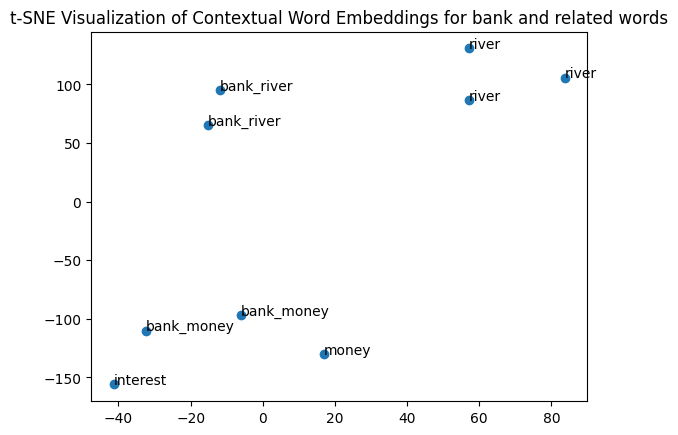

In [22]:
embeddings = torch.stack(word_emb_list).numpy()
tsne = TSNE(n_components=2, perplexity=3, random_state=42)
reduced = tsne.fit_transform(embeddings)

plt.scatter(reduced[:,0], reduced[:,1])
for i, label in enumerate(context_labels):
    plt.text(reduced[i,0], reduced[i,1], label)
plt.title("t-SNE Visualization of Contextual Word Embeddings for bank and related words")
plt.show()

We computed the cosine similarity between embeddings to quantify how close words are in the semantic space. As expected, the embedding for bank_money has a high cosine similarity with money and a low similarity with river. Conversely, bank_river is more similar to river than to money.

In [23]:
embeddings_np = torch.stack(word_emb_list).numpy()  

# Compute pairwise cosine similarities
sim_matrix = cosine_similarity(embeddings_np)  # shape [n_samples, n_samples]

# Print nicely
n = len(context_labels)
for i in range(n):
    for j in range(i+1, n):
        print(f"Cosine similarity between {context_labels[i]} (idx {i}) and {context_labels[j]} (idx {j}): {sim_matrix[i,j]:.4f}")

Cosine similarity between bank_river (idx 0) and bank_river (idx 1): 0.8626
Cosine similarity between bank_river (idx 0) and bank_money (idx 2): 0.4317
Cosine similarity between bank_river (idx 0) and bank_money (idx 3): 0.5284
Cosine similarity between bank_river (idx 0) and river (idx 4): 0.7277
Cosine similarity between bank_river (idx 0) and river (idx 5): 0.7130
Cosine similarity between bank_river (idx 0) and river (idx 6): 0.6893
Cosine similarity between bank_river (idx 0) and interest (idx 7): 0.3271
Cosine similarity between bank_river (idx 0) and money (idx 8): 0.3950
Cosine similarity between bank_river (idx 1) and bank_money (idx 2): 0.4927
Cosine similarity between bank_river (idx 1) and bank_money (idx 3): 0.5426
Cosine similarity between bank_river (idx 1) and river (idx 4): 0.7108
Cosine similarity between bank_river (idx 1) and river (idx 5): 0.7254
Cosine similarity between bank_river (idx 1) and river (idx 6): 0.7208
Cosine similarity between bank_river (idx 1) and 

#### AVG word level embedding analysis (ignore)

Avg not good so maybe ignore hehe

In [24]:
bank_river_avg = torch.stack([bank_river_emb1, bank_river_emb2]).mean(dim=0)
bank_money_avg = torch.stack([bank_money_emb1, bank_money_emb2]).mean(dim=0)
river_avg = torch.stack([river_emb1, river_emb2, river_emb3]).mean(dim=0)

word_emb_list2 = [bank_river_avg, bank_money_avg, river_avg, interest_emb1, money_emb1]

# Corresponding labels (for plotting)
context_labels2 = ['bank_river', 'bank_money', 'river', 'interest', 'money']

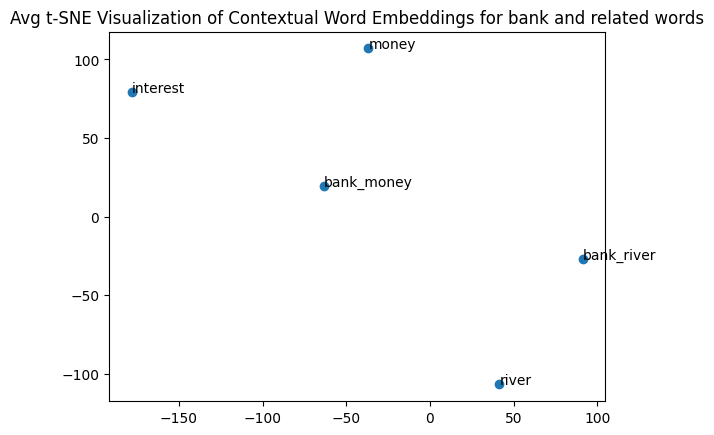

In [25]:
embeddings = torch.stack(word_emb_list2).numpy()
tsne = TSNE(n_components=2, perplexity=3, random_state=42)
reduced = tsne.fit_transform(embeddings)

plt.scatter(reduced[:,0], reduced[:,1])
for i, label in enumerate(context_labels2):
    plt.text(reduced[i,0], reduced[i,1], label)
plt.title("Avg t-SNE Visualization of Contextual Word Embeddings for bank and related words")
plt.show()

In [29]:
embeddings_np = torch.stack(word_emb_list2).numpy()  

# Compute pairwise cosine similarities
sim_matrix = cosine_similarity(embeddings_np)  # shape [n_samples, n_samples]

# Print nicely
n = len(context_labels2)
for i in range(n):
    for j in range(i+1, n):
        print(f"Cosine similarity between {context_labels2[i]} and {context_labels2[j]}: {sim_matrix[i,j]:.4f}")

Cosine similarity between bank_river and bank_money: 0.5490
Cosine similarity between bank_river and river: 0.7724
Cosine similarity between bank_river and interest: 0.3428
Cosine similarity between bank_river and money: 0.4276
Cosine similarity between bank_money and river: 0.5136
Cosine similarity between bank_money and interest: 0.5914
Cosine similarity between bank_money and money: 0.6401
Cosine similarity between river and interest: 0.3393
Cosine similarity between river and money: 0.4490
Cosine similarity between interest and money: 0.5501


#### Actual Pretrained

Hard to find words with multiple meanings, hence we only use example sentence to demonstrate.

### Sentence Level Embedding Analysis

#### Example

In [30]:
with torch.no_grad():
    outputs = model(**encoded)
    last_hidden_state = outputs.last_hidden_state  # [batch, seq, hidden]
    cls_embeddings = last_hidden_state[:, 0, :]  # CLS token
    mean_embeddings = last_hidden_state.mean(dim=1)

In [34]:
# Example: you have topic labels for coloring
topic_labels = ['river','money','river','money','river']  # as an example

topic_to_color = {
    'river': 'blue',
    'money': 'green',
}

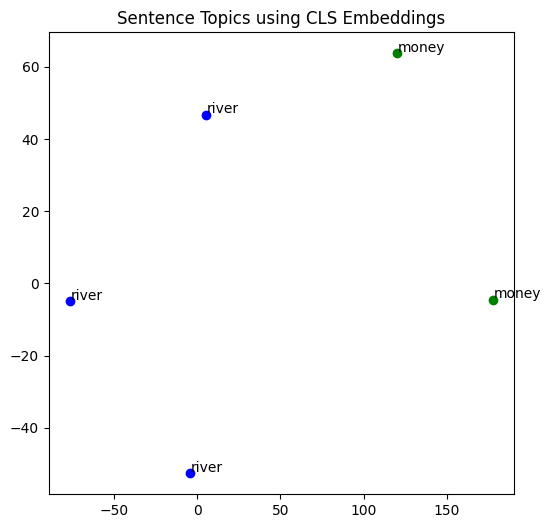

In [35]:
tsne_cls = TSNE(n_components=2, perplexity=3, random_state=42)
reduced_cls = tsne_cls.fit_transform(cls_embeddings.numpy())  # convert to numpy if torch tensor

plt.figure(figsize=(6,6))
for i, topic in enumerate(topic_labels):
    color = topic_to_color[topic]
    plt.scatter(reduced_cls[i,0], reduced_cls[i,1], c=color)
    plt.text(reduced_cls[i,0]+0.5, reduced_cls[i,1]+0.5, topic)

plt.title("Sentence Topics using CLS Embeddings")
plt.show()

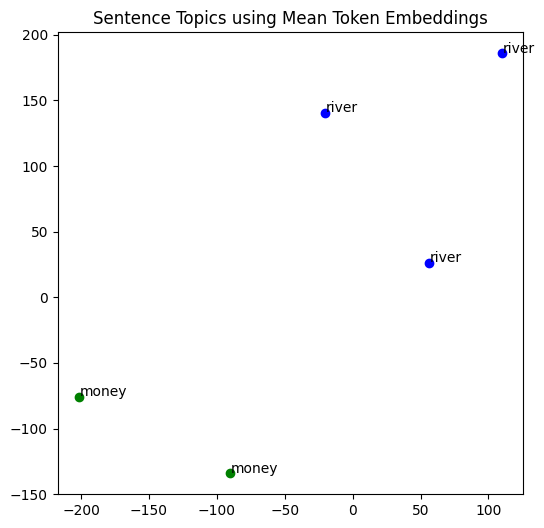

In [37]:
tsne_mean = TSNE(n_components=2, perplexity=3, random_state=42)
reduced_mean = tsne_mean.fit_transform(mean_embeddings.numpy())

plt.figure(figsize=(6,6))
for i, topic in enumerate(topic_labels):
    color = topic_to_color[topic]
    plt.scatter(reduced_mean[i,0], reduced_mean[i,1], c=color)
    plt.text(reduced_mean[i,0]+0.5, reduced_mean[i,1]+0.5, topic)

plt.title("Sentence Topics using Mean Token Embeddings")
plt.show()

#### Actual Data pretrained

We move from word-level to sentence-level embeddings.

In [46]:
n_samples_per_class = 20

# Subset 20 samples per label
df_subset = (
    train_df.groupby('label', group_keys=False)   # group by label
      .apply(lambda x: x.sample(n=n_samples_per_class, random_state=42))  # sample 20 per group
      .reset_index(drop=True)
)

print(df_subset['label'].value_counts())  # should show 20 per class
print(df_subset.head())

label
ABBR    20
DESC    20
ENTY    20
HUM     20
LOC     20
NUM     20
Name: count, dtype: int64
                                            text label
0  What is Mikhail Gorbachev 's middle initial ?  ABBR
1                What is the full form of .com ?  ABBR
2                                 What is LMDS ?  ABBR
3                     What does e.g. stand for ?  ABBR
4  When reading classified ads , what does EENTY  ABBR


C:\Users\yauju\AppData\Local\Temp\ipykernel_12108\2181324063.py:6: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  .apply(lambda x: x.sample(n=n_samples_per_class, random_state=42))  # sample 20 per group


In [47]:
encoded = tokenizer(df_subset['text'].tolist(), padding=True, truncation=True, return_tensors='pt')
topic_labels = df_subset['label'].tolist()

topic_to_color = {
    'DESC': 'blue',
    'ENTY': 'red',
    'ABBR': 'green',
    'HUM': 'orange',
    'NUM': 'purple',
    'LOC': 'yellow',
}
with torch.no_grad():
    outputs = model(**encoded)
    last_hidden_state = outputs.last_hidden_state  # [batch, seq, hidden]
    cls_embeddings = last_hidden_state[:, 0, :]  # CLS token
    mean_embeddings = last_hidden_state.mean(dim=1)

We experiment with using the [CLS] token embedding from the last layer as a sentence representation. While the t-SNE visualization shows some degree of clustering by semantic topic, the separation between groups is weak. Many clusters overlap, and sentences from different categories are often close together.

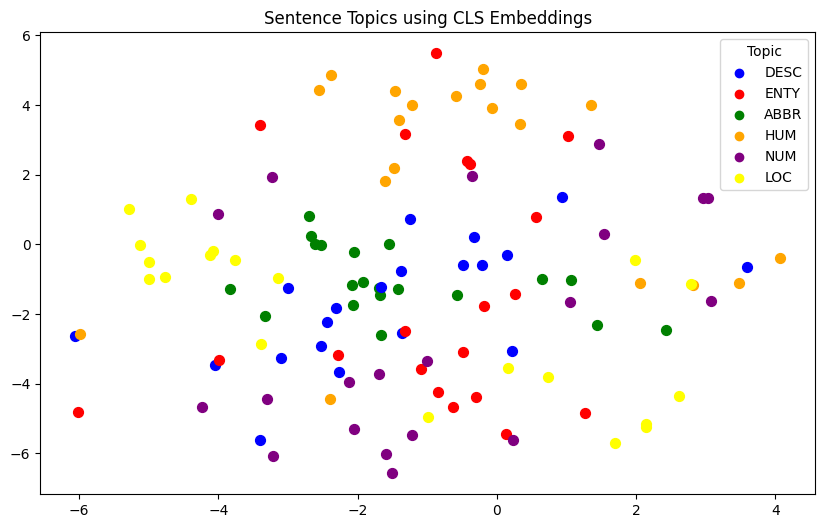

In [62]:
tsne_cls = TSNE(n_components=2, perplexity=30, random_state=42)
reduced_cls = tsne_cls.fit_transform(cls_embeddings.numpy())  # convert to numpy if torch tensor

plt.figure(figsize=(10,6))
for i, topic in enumerate(topic_labels):
    color = topic_to_color[topic]
    plt.scatter(reduced_cls[i,0], reduced_cls[i,1], c=color,s=50)
    # plt.text(reduced_cls[i,0]+0.5, reduced_cls[i,1]+0.5, topic)

for topic, color in topic_to_color.items():
    plt.scatter([], [], c=[color], label=topic)  # empty points for legend
plt.legend(title="Topic")

plt.title("Sentence Topics using CLS Embeddings")
plt.show()

For each sentence, we compute a sentence embedding by taking the mean of the last-layer embeddings of all its tokens. These sentence embeddings are then visualized using t-SNE.

The plot shows that semantically similar sentences tend to cluster together, particularly for topic labels LOC, HUM, NUM, and ABBR, whereas clustering is less distinct for ENTY and DESC. Sentences discussing similar topics or ideas appear close to each other, while sentences with very different content are positioned further apart. This suggests that the model captures sentence-level meaning to some extent, though additional training or fine-tuning may be required for better separation across all categories.

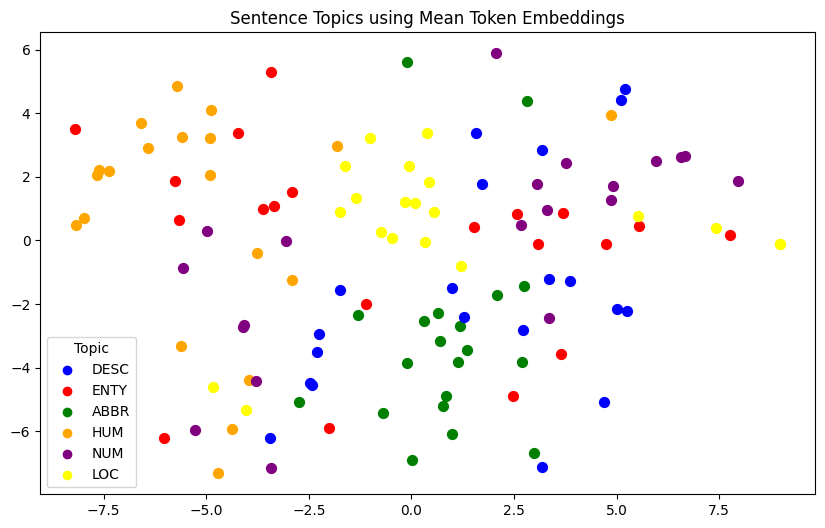

In [61]:
tsne_mean = TSNE(n_components=2, perplexity=30, random_state=42)
reduced_mean = tsne_mean.fit_transform(mean_embeddings.numpy())

plt.figure(figsize=(10,6))
for i, topic in enumerate(topic_labels):
    color = topic_to_color[topic]
    plt.scatter(reduced_mean[i,0], reduced_mean[i,1], c=color, s=50)
    # plt.text(reduced_mean[i,0]+0.5, reduced_mean[i,1]+0.5, topic)

for topic, color in topic_to_color.items():
    plt.scatter([], [], c=[color], label=topic)  # empty points for legend
plt.legend(title="Topic")

plt.title("Sentence Topics using Mean Token Embeddings")
plt.show()

## Traditional Augment

In [38]:
aug_list = [
    naw.ContextualWordEmbsAug(model_path='bert-base-uncased', action="insert", aug_p=0.1),
    naw.ContextualWordEmbsAug(model_path='bert-base-uncased', action="substitute", aug_p=0.1)
]

def augment_text(X_train, y_train, p_aug=0.3):
    new_text=[]
    new_label = []
    counter = 0
    ## data augmentation loop   
    for text, label in tqdm(zip(X_train, y_train), total=len(X_train)):
        augmented = False
        for aug in aug_list:
            if random.random() < p_aug:
                text = aug.augment(text)
                augmented = True
                
        if  augmented:
            counter += 1
            if isinstance(text, list):
                text = text[0]
            new_text.append(text)
            new_label.append(label)

    ## dataframe
    X_train.extend(new_text)
    y_train.extend(new_label)
    
    df=pd.DataFrame({'text':X_train, 'label':y_train}).sample(frac=1).reset_index(drop=True)

    return df['text'], df['label'], counter
    
X_train, y_train, augmented_count = augment_text(X_train.tolist(),y_train.tolist(), 0.3)

100%|██████████████████████████████████████████████████████████████████████████████| 4301/4301 [02:56<00:00, 24.33it/s]


In [63]:
# traditional augmented text sample
aug_df = df.sample(10)
for idx, row in aug_df.iterrows():
    print(row['text'])

("What magazine paid $5 , 000 for an eight-millimeter film of John F. Kennedy 's assassination ?", "what magazine paid $ 8 5, 000 for an eight - millimeter film of john paul f. year kennedy ' s assassination?")
('What is a handheld PC ?', 'so what is a handheld machine?')
('The Kentucky Horse Park is close to which American city ?', 'the kentucky national park is close at which american city?')
('How can I gain access to a spy satelite ?', 'how can i gain access to each single satelite?')
('What is the definition of a cascade ?', 'what is the definition now of a cascade?')
('What square is the geographical center of London ?', 'what square is the geographical centre of london?')
("What is the biblical meaning of ` stones ' ?", "what is the biblical meaning of ` these stones '?")
('How many engines does a Boeing 737 have ?', 'how many engines does even a boeing 737 have?')
("What 's the American dollar equivalent for 8 pounds in the U.K. ?", "what ' s his american male equivalent being 

In [39]:
print("augmented data: ", augmented_count)

augmented data:  2168


## LLM Augmenting

In [31]:
# access_token = EMPTY

# 1. Load the model and tokenizer
# model_name = "meta-llama/Llama-3.2-1B-Instruct"
# llm_tokenizer = AutoTokenizer.from_pretrained(model_name, use_auth_token=access_token)
# llm_model = LlamaForCausalLM.from_pretrained(model_name, torch_dtype=torch.float16, device_map="auto", use_auth_token=access_token)

model_name = "google/flan-t5-large"
llm_tokenizer = AutoTokenizer.from_pretrained(model_name)
llm_model = AutoModelForSeq2SeqLM.from_pretrained(model_name, dtype=torch.float16,  # half precision
    device_map="auto",
)

embedder = SentenceTransformer("sentence-transformers/paraphrase-MiniLM-L6-v2")

In [10]:
def generate_augment_llm(X_train, y_train, label_class):
    y_train_sub = y_train[y_train.isin(label_class)]
    X_train_sub = X_train.loc[y_train_sub.index]

    augmented_text_dict = {}
    augmented_label_dict = {}
    
    for text, label in tqdm(zip(X_train_sub, y_train_sub), total=len(y_train_sub)):
        augmented = []
        prompt =  f"Rephrase the question below without changing its meaning. Do NOT answer it.\n\nSentence: {text}\nRephrased:"
        inputs = llm_tokenizer(prompt, return_tensors="pt").to(llm_model.device)
        for _ in range(5):
            output = llm_model.generate(
                **inputs,
                max_new_tokens=50,
                temperature=0.8,   # adds variation
                top_p=0.9,
                do_sample=True,    # enables sampling (vs greedy)
                pad_token_id=llm_tokenizer.eos_token_id,
                eos_token_id=llm_tokenizer.eos_token_id
            )
            decoded = llm_tokenizer.decode(output[0], skip_special_tokens=True)
            try:
                rephrased = decoded.split("Rephrased:")[-1].split("\n")[0].strip()
                augmented.append(rephrased)
                
            except IndexError:
                # Skip this one if the expected pattern isn't found
                continue
        if augmented:  # only if at least one succeeded
            augmented_text_dict[text] = augmented
            augmented_label_dict[text] = label     
        
    return augmented_text_dict, augmented_label_dict

In [43]:
def generate_augment_llm_t5(X_train, y_train, label_class):
    y_train_sub = y_train[y_train.isin(label_class)]
    X_train_sub = X_train.loc[y_train_sub.index]

    augmented_text_dict = {}
    augmented_label_dict = {}
    
    for text, label in tqdm(zip(X_train_sub, y_train_sub), total=len(y_train_sub)):
        prompt =  f"Rephrase the question below without changing its meaning.\n\n{text}"
        inputs = llm_tokenizer(prompt, return_tensors="pt", truncation=True).to(llm_model.device)
        # for _ in range(5):
        outputs = llm_model.generate(
            **inputs,
            max_new_tokens=64,
            top_k=200,
            temperature=0.8,   # adds variation
            top_p=0.9,
            do_sample=True,    # enables sampling (vs greedy)
            num_return_sequences=5,
            num_beams=5
        )
        try:
            augmented = [
            llm_tokenizer.decode(seq, skip_special_tokens=True).strip()
            for seq in outputs
        ]
            
        except IndexError:
            # Skip this one if the expected pattern isn't found
            print("error")
        if augmented:  # only if at least one succeeded
            augmented_text_dict[text] = augmented
            augmented_label_dict[text] = label     
        
    return augmented_text_dict, augmented_label_dict

In [44]:
augmented_text_dict, augmented_label_dict = generate_augment_llm_t5(X_train,y_train, [2])

100%|██████████████████████████████████████████████████████████████████████████████████| 72/72 [01:04<00:00,  1.12it/s]


In [45]:
augmented_text_dict

{'What is HDLC ?': ['What is HDLC ?',
  'What is HDLC?',
  'What is High-density liquid chromatography ( HDLC ) ?',
  'What is High-density liquid chromatography ( HDLC )?',
  'What is High-density liquid chromatography (HDLC) ?'],
 "What 's the abbreviation for limited partnership ?": ["What 's the abbreviation for limited partnership ?",
  'What is the abbreviation for limited partnership ?',
  "What 's the abbreviation for a limited partnership ?",
  'What is the abbreviation for a limited partnership ?',
  "What 's the abbreviation for a limited company ?"],
 'What is SVHS ?': ['What is SVHS ?',
  'What is the abbreviation for SVHS ?',
  'What is SVHS?',
  'What is the abbreviation SVHS ?',
  'What is the abbreviation for SVHS?'],
 'What does CNN stand for ?': ['What does CNN stand for ?',
  'What does the acronym CNN stand for ?',
  'What is CNN stand for ?',
  'CNN stands for what ?',
  'What does CNN stand for?'],
 'What does BMW stand for ?': ['What does BMW stand for ?',
  'Wh

In [32]:
def is_good_paraphrase(original, candidate, min_sim=0.65, max_sim=0.98):
    emb = embedder.encode([original, candidate])
    sim = util.cos_sim(emb[0], emb[1]).item()
    return min_sim <= sim <= max_sim, sim

In [46]:
def filter_paraphrase(augmented_text_dict, top_k = 2):
    filtered_augmented = {}
    for key, values in augmented_text_dict.items():
        aug_list = []
        for value in values:
            sim_bool, sim = is_good_paraphrase(key, value)
            if sim_bool:
                aug_list.append((value,sim))
        sorted_augs = sorted(aug_list, key=lambda x: x[1], reverse=True)
        if sorted_augs:
            sorted_augs_sub = sorted_augs[:top_k]
            filtered_augmented[key] = sorted_augs_sub
        #     print(f"original_sentence: {key}, augmented sentence with highest score: {sorted_augs_sub[0][0]}, sim score = {sorted_augs_sub[0][1]:.4f}")
        #     print(f"original_sentence: {key}, augmented sentence with lowest score: {sorted_augs_sub[-1][0]}, sim score = {sorted_augs_sub[-1][1]:.4f}")
        # else:
        #     print(f"original_sentence: {key}, no paraphrases passed the similarity threshold.")

    return filtered_augmented
augmented_text_dict_filtered = filter_paraphrase(augmented_text_dict)

In [32]:
print(augmented_text_dict_filtered)

{'What is HDLC ?': [('What is HDLC protocol?', 0.8819389343261719)], "What 's the abbreviation for limited partnership ?": [('What is the acronym for limited partnership?', 0.9648383855819702)], 'What does CNN stand for ?': [('What does CNN stand for in English?', 0.9286143779754639), ('What is the acronym for CNN?', 0.8410291075706482)], 'What does BMW stand for ?': [('What is the origin of BMW?', 0.8544079065322876), ('What is the origin or meaning of the name BMW?', 0.8412203192710876)], 'What does Ms. , Miss , and Mrs. stand for ?': [('What do the titles of Ms., Miss, and Mrs. represent?', 0.8738323450088501), ('What is the meaning of the initials Ms., Miss, and Mrs.?', 0.8565558195114136)], 'What does LOL mean ?': [('What is the meaning of the word LOL?', 0.8808706402778625), ('What is the meaning of the word LOL?', 0.8808706402778625)], 'What is DEET ?': [('What is DEET used for?', 0.9221736788749695), ('What is the chemical compound commonly known as DEET?', 0.75974440574646)], 

In [47]:
# t5
print(augmented_text_dict_filtered)

{"What 's the abbreviation for limited partnership ?": [("What 's the abbreviation for a limited company ?", 0.7723271250724792)], 'What is SVHS ?': [('What is the abbreviation for SVHS ?', 0.893867015838623), ('What is the abbreviation for SVHS?', 0.893867015838623)], 'What does CNN stand for ?': [('CNN stands for what ?', 0.9375410676002502), ('What does the acronym CNN stand for ?', 0.8775562047958374)], 'What does BMW stand for ?': [('BMW stands for what ?', 0.9503307342529297)], 'What does Ms. , Miss , and Mrs. stand for ?': [('What does Ms , Miss , and Mrs stand for ?', 0.9662384986877441)], 'What does LOL mean ?': [('What is the meaning of LOL ?', 0.9248126745223999), ('What does LOL stand for ?', 0.8513540029525757)], 'What is DEET ?': [('What does DEET stand for ?', 0.9494461417198181), ('What is DEET and what does it do ?', 0.9360365867614746)], 'What does RCA stand for ?': [('What does the acronym RCA stand for ?', 0.9159800410270691)], "What 's the abbreviation for trinitro

In [29]:
# dict len (2 data doesnt have meaningful paraphrase)
print(len(augmented_text_dict_filtered))

# augmented count
total_length = sum(len(v) for v in augmented_text_dict_filtered.values())
print(total_length)

70
134


In [48]:
# dict len (8 data doesnt have meaningful paraphrase)
print(len(augmented_text_dict_filtered))

# augmented count (t5)
total_length = sum(len(v) for v in augmented_text_dict_filtered.values())
print(total_length)

64
112


In [33]:
# original unaugmented data count
206-134

72

In [49]:
def extend_train_df(X_train, y_train, augmented_text_dict_filtered, augmented_label_dict):
    for key, values in augmented_text_dict_filtered.items():
        for value in values:
            X_train.append(value[0])
            y_train.append(augmented_label_dict[key])
    
    df=pd.DataFrame({'text':X_train, 'label':y_train}).sample(frac=1).reset_index(drop=True)
    return df['text'], df['label']
X_train, y_train = extend_train_df(X_train.tolist(), y_train.tolist(), augmented_text_dict_filtered, augmented_label_dict)

In [51]:
y_train_sub = y_train[y_train.isin([2])]
X_train_sub = X_train.loc[y_train_sub.index]

In [59]:
X_train_sub.sample(20)

2353                           What does SIDS stand for ?
4270              What is the meaning of the word LASER ?
951                             What does HIV stand for ?
4171     IOC stands for International Olympic Committee .
2719                                       What is LMDS ?
3776    What does NN O `` mean when used as a prefix i...
4081                        What is RAM in the computer ?
3047                              What is a DTMF signal ?
3325                            What is the acronym SAP ?
3979                         What is the SIDS stand for ?
2239    What is the abbreviated form of the National B...
123                                        What is DTMF ?
433     What is the middle initial of Mikhail Gorbachev ?
789                  What is the memory in the computer ?
1190                 What does the word snafu stand for ?
1970                          What does NAFTA stand for ?
4191    What does NN O  mean when used as a prefix in ...
4280          

## Model init & Training

In [9]:
class TRECDataset(Dataset):
    def __init__(self, texts, labels, tokenizer, max_len):
        self.texts = texts
        self.labels = labels
        self.tokenizer = tokenizer
        self.max_len = max_len

    def __len__(self):
        return len(self.texts)

    def __getitem__(self, idx):
        text = self.texts.iloc[idx]
        label = self.labels.iloc[idx]
        encoding = self.tokenizer.encode_plus(
            text,
            truncation=True,
            add_special_tokens=True,
            max_length=self.max_len,
            return_token_type_ids=False,
            padding='max_length',
            return_attention_mask=True,
            return_tensors='pt'
        )

        return {
            'text': text,
            'input_ids': encoding['input_ids'].flatten(),
            'attention_mask': encoding['attention_mask'].flatten(),
            'label': torch.tensor(label, dtype=torch.long)
        }

tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')

In [53]:
MAX_LEN = 50
BATCH_SIZE = 32

train_dataset = TRECDataset(X_train, y_train, tokenizer, MAX_LEN)
val_dataset = TRECDataset(X_val, y_val, tokenizer, MAX_LEN)
test_dataset = TRECDataset(X_test, y_test, tokenizer, MAX_LEN)

train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=BATCH_SIZE, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=BATCH_SIZE)

In [54]:
# BertConfig, increase dropout prob
config = BertConfig.from_pretrained('bert-base-uncased',
                                    num_labels=6,
                                    hidden_dropout_prob=0.3,
                                    attention_probs_dropout_prob=0.3)


# # Create model with modified config
model = BertForSequenceClassification.from_pretrained('bert-base-uncased', config=config)

model = model.to(device)

# Optimizer and learning rate scheduler
optimizer = torch.optim.AdamW(model.parameters(), lr=2e-5)

Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [12]:
def train_epoch(model, data_loader, val_loader, optimizer, device):
    model.train()

    running_loss = 0.0
    correct_predictions = 0
    total_samples_seen = 0

    # --- Training phase ---
    for batch in tqdm(data_loader):
        input_ids = batch['input_ids'].to(device)
        attention_mask = batch['attention_mask'].to(device)
        labels = batch['label'].to(device)

        # Forward
        outputs = model(input_ids=input_ids, attention_mask=attention_mask, labels=labels)
        loss = outputs.loss
        logits = outputs.logits

        # Predictions & metrics
        _, preds = torch.max(logits, dim=1)
        correct_predictions += torch.sum(preds == labels)
        running_loss += loss.item()
        total_samples_seen += labels.size(0)

        # Backpropagation
        loss.backward()
        optimizer.step()
        optimizer.zero_grad()

    # --- Compute epoch-level metrics ---
    avg_train_loss = running_loss / len(data_loader)
    train_acc = correct_predictions.double() / total_samples_seen

    # --- Validation phase ---
    val_acc, avg_val_loss = evaluate_model(model, val_loader, device)

    # --- Record metrics globally ---
    training_losses.append(avg_train_loss)
    val_losses.append(avg_val_loss)
    train_accuracies.append(train_acc.item())
    val_accuracies.append(val_acc.item())

    print(f"Train Loss: {avg_train_loss:.4f} | Train Acc: {train_acc:.4f}")
    print(f"Val   Loss: {avg_val_loss:.4f} | Val Acc: {val_acc:.4f}")


In [13]:
def evaluate_model(model, data_loader, device):
    model.eval()
    total_loss = 0.0
    correct_predictions = 0
    total_samples = 0

    with torch.no_grad():
        for batch in data_loader:
            input_ids = batch['input_ids'].to(device)
            attention_mask = batch['attention_mask'].to(device)
            labels = batch['label'].to(device)

            outputs = model(input_ids=input_ids, attention_mask=attention_mask, labels=labels)
            loss = outputs.loss
            logits = outputs.logits

            _, preds = torch.max(logits, dim=1)
            correct_predictions += torch.sum(preds == labels)
            total_loss += loss.item()
            total_samples += labels.size(0)

    avg_loss = total_loss / len(data_loader)
    accuracy = correct_predictions.double() / total_samples
    return accuracy, avg_loss


### No augment

In [14]:
# no augment
training_losses = []
val_losses = []
train_accuracies = []
val_accuracies = []

EPOCHS = 5
step_count = 0
for epoch in range(EPOCHS):
    print(f'Epoch {epoch + 1}/{EPOCHS}')
    start_time = time.time()
    train_epoch(model, train_loader, val_loader, optimizer, device)
    print(f'time taken: {time.time()-start_time}')

Epoch 1/5


100%|████████████████████████████████████████████████████████████████████████████████| 135/135 [01:00<00:00,  2.22it/s]


Train Loss: 1.3290 | Train Acc: 0.4704
Val   Loss: 0.6106 | Val Acc: 0.8030
time taken: 66.46956181526184
Epoch 2/5


100%|████████████████████████████████████████████████████████████████████████████████| 135/135 [01:00<00:00,  2.24it/s]


Train Loss: 0.5031 | Train Acc: 0.8463
Val   Loss: 0.2717 | Val Acc: 0.9173
time taken: 66.00597882270813
Epoch 3/5


100%|████████████████████████████████████████████████████████████████████████████████| 135/135 [01:02<00:00,  2.16it/s]


Train Loss: 0.2900 | Train Acc: 0.9089
Val   Loss: 0.2094 | Val Acc: 0.9433
time taken: 68.6354558467865
Epoch 4/5


100%|████████████████████████████████████████████████████████████████████████████████| 135/135 [01:03<00:00,  2.12it/s]


Train Loss: 0.1945 | Train Acc: 0.9437
Val   Loss: 0.2143 | Val Acc: 0.9442
time taken: 70.11439514160156
Epoch 5/5


100%|████████████████████████████████████████████████████████████████████████████████| 135/135 [01:04<00:00,  2.08it/s]


Train Loss: 0.1640 | Train Acc: 0.9500
Val   Loss: 0.2033 | Val Acc: 0.9387
time taken: 70.9206976890564


### Traditional Augment

In [42]:
# traditional augment
training_losses = []
train_accuracies = []
val_accuracies = []

EPOCHS = 5
step_count = 0
for epoch in range(EPOCHS):
    print(f'Epoch {epoch + 1}/{EPOCHS}')
    start_time = time.time()
    train_acc, step_count = train_epoch(model, train_loader, val_loader, optimizer, device, step_count)
    train_accuracies.extend(train_acc)
    print(f'time taken: {time.time()-start_time}')

Epoch 1/5


100%|████████████████████████████████████████████████████████████████████████████████| 203/203 [01:41<00:00,  2.00it/s]


time taken: 101.37654519081116
Epoch 2/5


100%|████████████████████████████████████████████████████████████████████████████████| 203/203 [01:45<00:00,  1.93it/s]


time taken: 105.23046875
Epoch 3/5


100%|████████████████████████████████████████████████████████████████████████████████| 203/203 [01:47<00:00,  1.88it/s]


time taken: 107.85578989982605
Epoch 4/5


100%|████████████████████████████████████████████████████████████████████████████████| 203/203 [01:48<00:00,  1.87it/s]


time taken: 108.34202837944031
Epoch 5/5


100%|████████████████████████████████████████████████████████████████████████████████| 203/203 [01:49<00:00,  1.86it/s]

time taken: 109.30726861953735


### LLM Augment (3.4)

In [21]:
# llama augment
training_losses = []
val_losses
train_accuracies = []
val_accuracies = []

EPOCHS = 5
for epoch in range(EPOCHS):
    print(f'Epoch {epoch + 1}/{EPOCHS}')
    start_time = time.time()
    train_epoch(model, train_loader, val_loader, optimizer, device)
    print(f'time taken: {time.time()-start_time}')

Epoch 1/5


100%|████████████████████████████████████████████████████████████████████████████████| 139/139 [01:11<00:00,  1.95it/s]


time taken: 71.12518262863159
Epoch 2/5


100%|████████████████████████████████████████████████████████████████████████████████| 139/139 [01:12<00:00,  1.93it/s]


time taken: 72.08024144172668
Epoch 3/5


100%|████████████████████████████████████████████████████████████████████████████████| 139/139 [01:18<00:00,  1.77it/s]


time taken: 78.71902990341187
Epoch 4/5


100%|████████████████████████████████████████████████████████████████████████████████| 139/139 [01:13<00:00,  1.90it/s]


time taken: 73.12777066230774
Epoch 5/5


100%|████████████████████████████████████████████████████████████████████████████████| 139/139 [01:13<00:00,  1.88it/s]

time taken: 73.86891579627991


In [55]:
# t5 augment
training_losses = []
val_losses = []
train_accuracies = []
val_accuracies = []

EPOCHS = 5
for epoch in range(EPOCHS):
    print(f'Epoch {epoch + 1}/{EPOCHS}')
    start_time = time.time()
    train_epoch(model, train_loader, val_loader, optimizer, device)
    print(f'time taken: {time.time()-start_time}')

Epoch 1/5


100%|████████████████████████████████████████████████████████████████████████████████| 138/138 [01:00<00:00,  2.26it/s]


Train Loss: 1.3811 | Train Acc: 0.4611
Val   Loss: 0.6695 | Val Acc: 0.7788
time taken: 66.73509693145752
Epoch 2/5


100%|████████████████████████████████████████████████████████████████████████████████| 138/138 [01:01<00:00,  2.23it/s]


Train Loss: 0.5509 | Train Acc: 0.8307
Val   Loss: 0.2814 | Val Acc: 0.9191
time taken: 67.89040517807007
Epoch 3/5


100%|████████████████████████████████████████████████████████████████████████████████| 138/138 [01:04<00:00,  2.13it/s]


Train Loss: 0.3241 | Train Acc: 0.9032
Val   Loss: 0.2339 | Val Acc: 0.9331
time taken: 70.86637473106384
Epoch 4/5


100%|████████████████████████████████████████████████████████████████████████████████| 138/138 [01:06<00:00,  2.08it/s]


Train Loss: 0.2246 | Train Acc: 0.9334
Val   Loss: 0.2015 | Val Acc: 0.9405
time taken: 72.52322173118591
Epoch 5/5


100%|████████████████████████████████████████████████████████████████████████████████| 138/138 [01:06<00:00,  2.08it/s]


Train Loss: 0.1691 | Train Acc: 0.9497
Val   Loss: 0.2174 | Val Acc: 0.9405
time taken: 72.5757372379303


## Analysis

In [23]:
def print_fig():
    epochs = [i for i in range(EPOCHS)]
    fig , ax = plt.subplots(1,2)
    fig.set_size_inches(10,4)
        
    ax[0].plot(range(1, len(training_losses) + 1),
               training_losses,
               color='tab:blue', marker='', linestyle='-',
               label='Train')
    ax[0].plot(range(1, len(val_losses) + 1),
               val_losses,
               color='tab:orange', marker='', linestyle='-',
               label='Val')
    ax[0].set_title('Loss',  fontsize=12)
    ax[0].set_xlabel("Epoch",  fontsize=10)
    ax[0].set_ylabel("Loss",  fontsize=10)
    ax[0].grid(alpha=0.3)
    ax[0].legend(frameon=False)
    
    ax[1].plot(range(1, len(train_accuracies) + 1),
               train_accuracies,
               color='tab:blue', marker='', linestyle='-',
               label='Train')
    
    ax[1].plot(range(1, len(val_accuracies) + 1),
               val_accuracies,
               color='tab:orange', marker='', linestyle='-',
               label='Val')
    
    ax[1].set_title('Accuracy', fontsize=12)
    ax[1].set_xlabel('Epoch', fontsize=10)
    ax[1].set_ylabel('Accuracy', fontsize=10)
    ax[1].grid(alpha=0.3)
    ax[1].legend(frameon=False)
    
    plt.tight_layout(pad=2.0)
    plt.show()
    print("train accs: ",train_accuracies)
    print("val accs: ",val_accuracies)

In [25]:
def predict_test_set():
    # Evaluate the model on test set
    correct_predictions = 0
    
    model.eval()
    with torch.no_grad():
        for batch in test_loader:
            input_ids = batch['input_ids'].to(device)
            attention_mask = batch['attention_mask'].to(device)
            labels = batch['label'].to(device)
    
            outputs = model(input_ids=input_ids, attention_mask=attention_mask)
            logits = outputs.logits
            _, preds = torch.max(logits, dim=1)
    
            correct_predictions += torch.sum(preds == labels)
    
    print("test accuracies = ", (correct_predictions.double() / len(test_loader.dataset)).cpu().numpy().item())
    return 

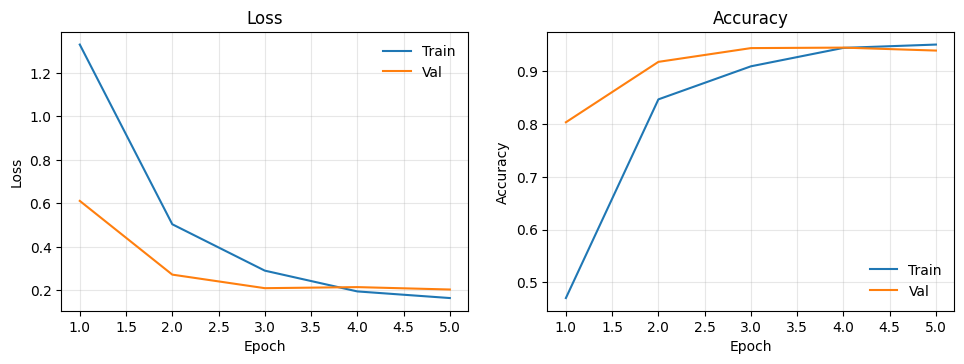

train accs:  [0.47035573122529645, 0.8463148105091839, 0.9088584050220879, 0.9437340153452686, 0.9500116252034411]
val accs:  [0.8029739776951672, 0.9172862453531598, 0.9433085501858736, 0.9442379182156133, 0.9386617100371747]


In [24]:
# bert 5 epoch dropout
print_fig()

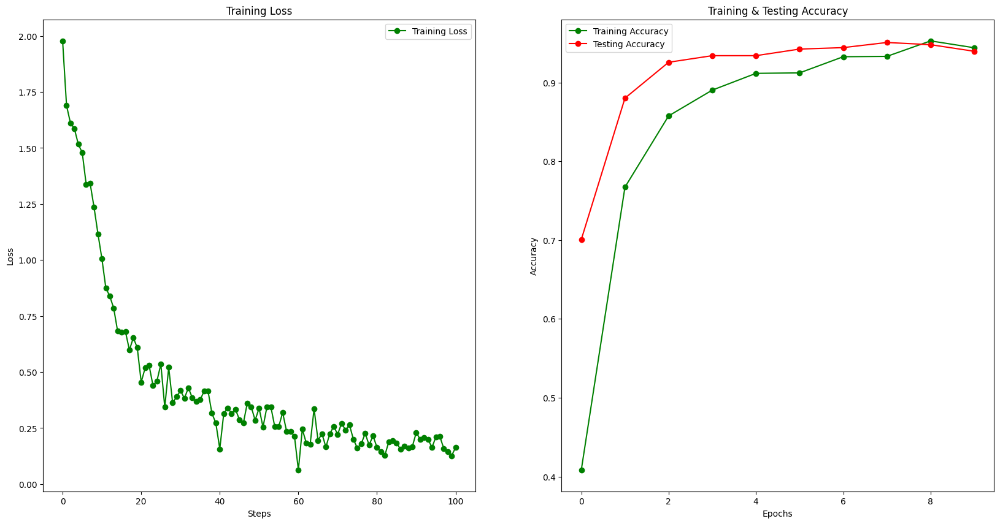

train accs:  [0.4084375, 0.7671875, 0.8576030927835051, 0.8903125000000001, 0.9115691489361701, 0.9121875, 0.9326923076923078, 0.933125, 0.9527698863636364, 0.9440625]
val accs:  [0.7007434944237918, 0.8801115241635687, 0.9256505576208178, 0.9340148698884758, 0.9340148698884758, 0.9423791821561338, 0.9442379182156133, 0.9507434944237918, 0.9479553903345724, 0.9395910780669144]


In [43]:
# bert 5 epoch dropout traditional augment
print_fig()

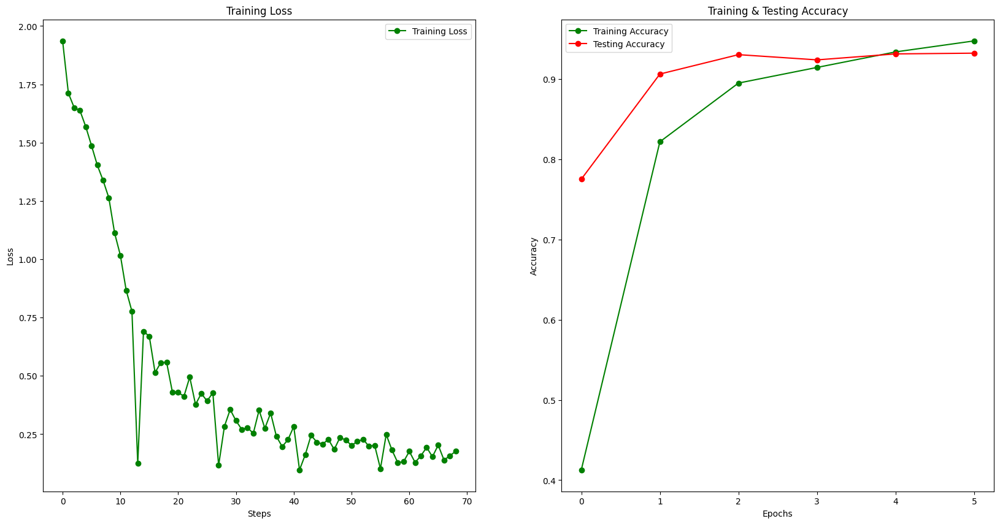

train accs:  [0.4128125, 0.8217213114754098, 0.8948863636363636, 0.914375, 0.9337349397590362, 0.9474431818181819]
val accs:  [0.775092936802974, 0.9061338289962825, 0.9302973977695167, 0.9237918215613382, 0.9312267657992565, 0.9321561338289962]


In [24]:
# bert 5 epoch dropout llm augment
print_fig()

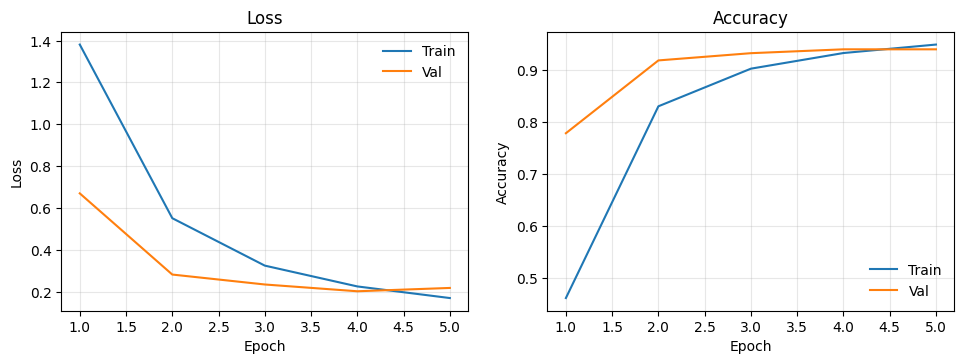

train accs:  [0.4611375481531838, 0.8307273963290279, 0.9032404260140494, 0.9333786539768865, 0.9496940856560163]
val accs:  [0.7788104089219331, 0.9191449814126393, 0.9330855018587361, 0.9405204460966542, 0.9405204460966542]


In [56]:
# bert 5 epoch dropout llm augment t5
print_fig()

In [26]:
# bert 5 epoch dropout 
# no augment
predict_test_set()

test accuracies =  0.97


In [44]:
# bert 5 epoch dropout
# traditional augment
predict_test_set()

test accuracies =  0.962


In [25]:
# bert 5 epoch dropout
# llm augment
predict_test_set()

test accuracies =  0.98


In [58]:
# bert 5 epoch dropout
# llm augment t5
predict_test_set()

test accuracies =  0.962


In [27]:
model.save_pretrained("./saved_model/model_bert/")

In [19]:
# model = BertForSequenceClassification.from_pretrained('./saved_model/model_bert')

## Post Finetune Analysis

In [9]:
model_path = "./saved_model/model_bert"
tokenizer = BertTokenizer.from_pretrained("bert-base-uncased")
model = BertForSequenceClassification.from_pretrained(model_path, output_attentions=True, output_hidden_states=True)
model.eval()

BertForSequenceClassification(
  (bert): BertModel(
    (embeddings): BertEmbeddings(
      (word_embeddings): Embedding(30522, 768, padding_idx=0)
      (position_embeddings): Embedding(512, 768)
      (token_type_embeddings): Embedding(2, 768)
      (LayerNorm): LayerNorm((768,), eps=1e-12, elementwise_affine=True)
      (dropout): Dropout(p=0.3, inplace=False)
    )
    (encoder): BertEncoder(
      (layer): ModuleList(
        (0-11): 12 x BertLayer(
          (attention): BertAttention(
            (self): BertSelfAttention(
              (query): Linear(in_features=768, out_features=768, bias=True)
              (key): Linear(in_features=768, out_features=768, bias=True)
              (value): Linear(in_features=768, out_features=768, bias=True)
              (dropout): Dropout(p=0.3, inplace=False)
            )
            (output): BertSelfOutput(
              (dense): Linear(in_features=768, out_features=768, bias=True)
              (LayerNorm): LayerNorm((768,), eps=1e-12,

### Sentence Lvl Embedding Analysis

In [10]:
encoded = tokenizer(test_df['text'].tolist(), padding=True, truncation=True, return_tensors='pt')
topic_labels = test_df['label'].tolist()

topic_to_color = {
    'DESC': 'blue',
    'ENTY': 'red',
    'ABBR': 'green',
    'HUM': 'orange',
    'NUM': 'purple',
    'LOC': 'yellow',
}
with torch.no_grad():
    outputs = model(**encoded)
    last_hidden_state = outputs.hidden_states[-1]  # [batch, seq, hidden]
    cls_embeddings = last_hidden_state[:, 0, :]  # CLS token
    mean_embeddings = last_hidden_state.mean(dim=1)

CLS Embedding

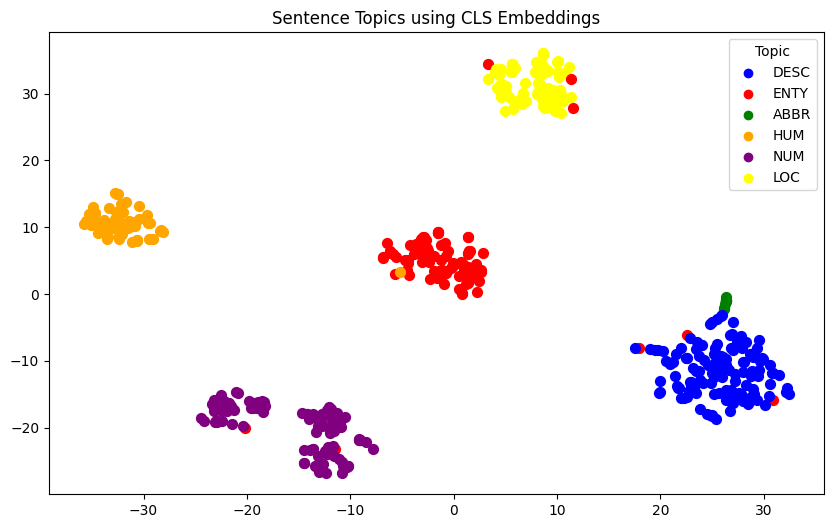

In [11]:
tsne_cls = TSNE(n_components=2, perplexity=30, random_state=42)
reduced_cls = tsne_cls.fit_transform(cls_embeddings.numpy())  # convert to numpy if torch tensor

plt.figure(figsize=(10,6))
for i, topic in enumerate(topic_labels):
    color = topic_to_color[topic]
    plt.scatter(reduced_cls[i,0], reduced_cls[i,1], c=color,s=50)
    # plt.text(reduced_cls[i,0]+0.5, reduced_cls[i,1]+0.5, topic)

for topic, color in topic_to_color.items():
    plt.scatter([], [], c=[color], label=topic)  # empty points for legend
plt.legend(title="Topic")

plt.title("Sentence Topics using CLS Embeddings")
plt.show()

Mean Embedding

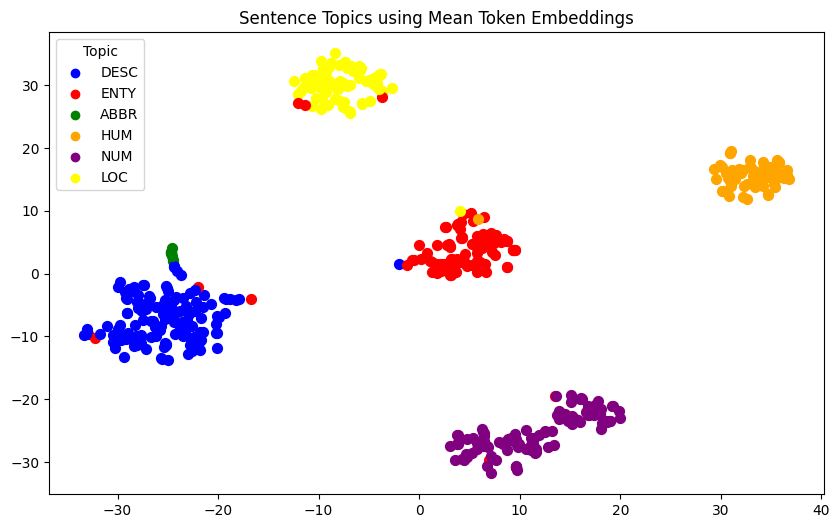

In [12]:
tsne_mean = TSNE(n_components=2, perplexity=30, random_state=42)
reduced_mean = tsne_mean.fit_transform(mean_embeddings.numpy())

plt.figure(figsize=(10,6))
for i, topic in enumerate(topic_labels):
    color = topic_to_color[topic]
    plt.scatter(reduced_mean[i,0], reduced_mean[i,1], c=color, s=50)
    # plt.text(reduced_mean[i,0]+0.5, reduced_mean[i,1]+0.5, topic)

for topic, color in topic_to_color.items():
    plt.scatter([], [], c=[color], label=topic)  # empty points for legend
plt.legend(title="Topic")

plt.title("Sentence Topics using Mean Token Embeddings")
plt.show()

### Attn Analysis

In [13]:
sampled_df = test_df.groupby('label').apply(lambda x: x.sample(3, random_state=42)).reset_index(drop=True)

# Display the result
print(sampled_df)

                                                 text label
0                          What does NASA stand for ?  ABBR
1                          What does I.V. stand for ?  ABBR
2                           What does CPR stand for ?  ABBR
3                             Why is the sun yellow ?  DESC
4                                What is an annuity ?  DESC
5                            What are triglycerides ?  DESC
6             What instrument did Glenn Miller play ?  ENTY
7     What primary colors do you mix to make orange ?  ENTY
8                 What is the Illinois state flower ?  ENTY
9                   What is Shakespeare 's nickname ?   HUM
10  Who is the actress known for her role in the m...   HUM
11                                  Who was Galileo ?   HUM
12             Where is the Shawnee National Forest ?   LOC
13           What county is Modesto , California in ?   LOC
14                  Where are the National Archives ?   LOC
15                What is the melting po

C:\Users\yauju\AppData\Local\Temp\ipykernel_16644\2152948948.py:1: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  sampled_df = test_df.groupby('label').apply(lambda x: x.sample(3, random_state=42)).reset_index(drop=True)


We used BertViz’s head_view to visualize attention patterns in the fine-tuned BERT model. This tool shows how each token attends to other tokens across different layers and heads. By examining these attention patterns, we can interpret which tokens the model considers most relevant for understanding context, identify key dependencies in sentences, and gain insights into the model’s decision-making process.

In [16]:
for idx, row in sampled_df.iterrows():
    text = row['text']  # replace 'text' with your actual column name
    label = row['label']
    
    print(f"Sample {idx} | Label: {label}")
    print(f"Text: {text}\n")
    
    # Tokenize input
    inputs = tokenizer(text, return_tensors='pt', truncation=True, max_length=128)
    
    # Get model outputs (with attention)
    with torch.no_grad():
        outputs = model(**inputs)
    
    # Visualize attention for this example
    head_view(
        outputs.attentions,
        tokenizer.convert_ids_to_tokens(inputs['input_ids'][0]),
        include_layers=None  # show all layers
    )
    

Sample 0 | Label: ABBR
Text: What does NASA stand for ?



<IPython.core.display.Javascript object>

Sample 1 | Label: ABBR
Text: What does I.V. stand for ?



<IPython.core.display.Javascript object>

Sample 2 | Label: ABBR
Text: What does CPR stand for ?



<IPython.core.display.Javascript object>

Sample 3 | Label: DESC
Text: Why is the sun yellow ?



<IPython.core.display.Javascript object>

Sample 4 | Label: DESC
Text: What is an annuity ?



<IPython.core.display.Javascript object>

Sample 5 | Label: DESC
Text: What are triglycerides ?



<IPython.core.display.Javascript object>

Sample 6 | Label: ENTY
Text: What instrument did Glenn Miller play ?



<IPython.core.display.Javascript object>

Sample 7 | Label: ENTY
Text: What primary colors do you mix to make orange ?



<IPython.core.display.Javascript object>

Sample 8 | Label: ENTY
Text: What is the Illinois state flower ?



<IPython.core.display.Javascript object>

Sample 9 | Label: HUM
Text: What is Shakespeare 's nickname ?



<IPython.core.display.Javascript object>

Sample 10 | Label: HUM
Text: Who is the actress known for her role in the movie `` Gypsy '' ?



<IPython.core.display.Javascript object>

Sample 11 | Label: HUM
Text: Who was Galileo ?



<IPython.core.display.Javascript object>

Sample 12 | Label: LOC
Text: Where is the Shawnee National Forest ?



<IPython.core.display.Javascript object>

Sample 13 | Label: LOC
Text: What county is Modesto , California in ?



<IPython.core.display.Javascript object>

Sample 14 | Label: LOC
Text: Where are the National Archives ?



<IPython.core.display.Javascript object>

Sample 15 | Label: NUM
Text: What is the melting point of gold ?



<IPython.core.display.Javascript object>

Sample 16 | Label: NUM
Text: When did Idaho become a state ?



<IPython.core.display.Javascript object>

Sample 17 | Label: NUM
Text: How far is a nautical mile ?



<IPython.core.display.Javascript object>

The code extracts attention values from the last layer of the fine-tuned BERT model. By averaging across all heads and focusing on the [CLS] token, it produces a vector that quantifies how much the [CLS] token attends to each token in the input sentence.

The purpose of this is to interpret the model’s focus when forming a sentence-level representation. High attention values indicate tokens that the model considers most relevant for understanding the overall meaning.

In [ ]:
for idx, row in sampled_df.iterrows():
    text = row['text']  # replace 'text' with your actual column name
    label = row['label']
    
    print(f"Sample {idx} | Label: {label}")
    print(f"Text: {text}\n")
    
    # Tokenize input
    inputs = tokenizer(text, return_tensors='pt', truncation=True, max_length=128)
    
    # Get model outputs (with attention)
    with torch.no_grad():
        outputs = model(**inputs)
    attentions = outputs.attentions

    last_layer_attn = attentions[-1]  # shape: (1, 12, seq_len, seq_len)

    # Average across heads
    avg_attn = last_layer_attn.mean(dim=1)  # shape: (1, seq_len, seq_len)
    
    # Extract attention *from* [CLS] token (position 0)
    cls_attention = avg_attn[0, 0] 

    tokens = tokenizer.convert_ids_to_tokens(inputs["input_ids"][0])

    attn_df = pd.DataFrame({
        "token": tokens,
        "attention_from_CLS": cls_attention.numpy()
    })
    
    # Sort by strongest attention
    attn_df = attn_df.sort_values("attention_from_CLS", ascending=False)
    print(attn_df)

Sample 0 | Label: ABBR
Text: What does NASA stand for ?

   token  attention_from_CLS
4  stand            0.164271
5    for            0.140807
2   does            0.140445
1   what            0.124707
3   nasa            0.121271
6      ?            0.118597
0  [CLS]            0.112032
7  [SEP]            0.077871
Sample 1 | Label: ABBR
Text: What does I.V. stand for ?

    token  attention_from_CLS
7   stand            0.118589
8     for            0.105746
2    does            0.102474
1    what            0.095514
3       i            0.093256
6       .            0.090442
0   [CLS]            0.089703
9       ?            0.085830
5       v            0.080873
4       .            0.075890
10  [SEP]            0.061684
Sample 2 | Label: ABBR
Text: What does CPR stand for ?

   token  attention_from_CLS
5  stand            0.145955
6    for            0.123995
2   does            0.122054
1   what            0.112116
4    ##r            0.106939
0  [CLS]            0.104821
7     

### SHAP Analysis

We used SHAP (SHapley Additive Explanations) to interpret the fine-tuned model’s predictions. SHAP is a model-agnostic interpretability method based on game theory, which assigns each feature (in this case, each token in the text) a contribution score indicating how much it influences the model’s output for a given class.

For each input sample, SHAP generates one force plot per class (six in total, since the model performs six-class classification). Each plot visualizes how individual tokens push the model’s prediction toward or away from that specific class. Tokens with positive SHAP values contribute to increasing the probability of that class, while tokens with negative values reduce it.

By comparing across classes, we can see which class the model favors—the correct class typically corresponds to the plot with the highest output score—and identify which words most strongly influenced that decision.

In [34]:
index_to_label

{0: 'DESC', 1: 'ENTY', 2: 'ABBR', 3: 'HUM', 4: 'NUM', 5: 'LOC'}

In [18]:
def f(texts):
    # Ensure 'texts' is a list of strings for batch tokenization
    # SHAP often passes a numpy array of strings, so we convert it to a list
    if isinstance(texts, str):
        texts = [texts]
    elif isinstance(texts, (list, tuple)):
        # Ensure elements are strings, common case: list of strings
        texts = [str(t) for t in texts]
    elif hasattr(texts, 'tolist'):
        # Handles numpy array of strings passed by SHAP
        texts = texts.tolist()
    
    # The rest of the function remains the same
    encoded = tokenizer(texts, return_tensors="pt", padding=True, truncation=True)
    with torch.no_grad():
        # Using .logits is correct for AutoModelForSequenceClassification
        logits = model(**encoded).logits
    return logits.numpy()

# Create masker for text
masker = shap.maskers.Text(tokenizer)

# Create SHAP explainer
explainer = shap.Explainer(f, masker=masker)

# Compute SHAP values
shap_values = explainer(sampled_df["text"].tolist())

# Visualize
for idx, row in sampled_df.iterrows():
    print(f"\nExplanation for: {row['text']}, Label: {row['label']}")
    shap.plots.text(shap_values[idx])

PartitionExplainer explainer:  61%|███████████████████████████████▊                    | 11/18 [00:12<00:05,  1.20it/s]

  0%|          | 0/342 [00:00<?, ?it/s]

PartitionExplainer explainer: 19it [00:33,  3.06s/it]                                                                  


Explanation for: What does NASA stand for ?, Label: ABBR



Explanation for: What does I.V. stand for ?, Label: ABBR



Explanation for: What does CPR stand for ?, Label: ABBR



Explanation for: Why is the sun yellow ?, Label: DESC



Explanation for: What is an annuity ?, Label: DESC



Explanation for: What are triglycerides ?, Label: DESC



Explanation for: What instrument did Glenn Miller play ?, Label: ENTY



Explanation for: What primary colors do you mix to make orange ?, Label: ENTY



Explanation for: What is the Illinois state flower ?, Label: ENTY



Explanation for: What is Shakespeare 's nickname ?, Label: HUM



Explanation for: Who is the actress known for her role in the movie `` Gypsy '' ?, Label: HUM



Explanation for: Who was Galileo ?, Label: HUM



Explanation for: Where is the Shawnee National Forest ?, Label: LOC



Explanation for: What county is Modesto , California in ?, Label: LOC



Explanation for: Where are the National Archives ?, Label: LOC



Explanation for: What is the melting point of gold ?, Label: NUM



Explanation for: When did Idaho become a state ?, Label: NUM



Explanation for: How far is a nautical mile ?, Label: NUM
